<a href="https://colab.research.google.com/github/NLMVEN/lopezven/blob/main/3D_Terrain_Model_Analysis.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!pip install rasterio geopandas matplotlib shapely
!pip install rasterio numpy matplotlib shapely geopandas
!pip install rasterio folium numpy matplotlib
!pip install rasterio folium numpy matplotlib scikit-image
!pip install rasterio geopandas plotly pyproj
!pip install rasterio numpy geopandas shapely matplotlib simplekml
!apt-get install gdal-bin saga -qq
!pip install rasterio
!pip install sentinelhub
!pip install pysheds




   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 22.2/22.2 MB 35.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 53.0/53.0 kB 2.2 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for simplekml: filename=simplekml-1.3.6-py3-none-any.whl size=65860 sha256=783bb499342e5e61d424edf836650d68dea9f66ead3d001eed8c42daf48f7fc5
  Stored in directory: /root/.cache/pip/wheels/72/3e/80/c3e5c354c3cbe62d8c5e4fb63d9e7cdccc7f93399997ae465f
Successfully built simplekml
Selecting previously unselected package python3-numpy.
(Reading database ... 126315 files and directories currently installed.)
Preparing to unpack .../00-python3-numpy_1%3a1.21.5-1ubuntu22.04.1_amd64.deb ...
Unpacking python3-numpy (1:1.21.5-1ubuntu22.04.1) ...
Selecting previously unselected package python3-gdal.
Preparing to unpack .../01-python3-gdal_3.6.4+dfsg-1~jammy0_amd64.deb ...
Unpacking python3-gdal (3.6.4+dfsg-1~jammy0) ...
Selecting previously unselected package gdal-bin.
Preparing to unpac

In [2]:
!apt-get install -qq libgdal-dev
!pip install -q rasterio geopandas plotly

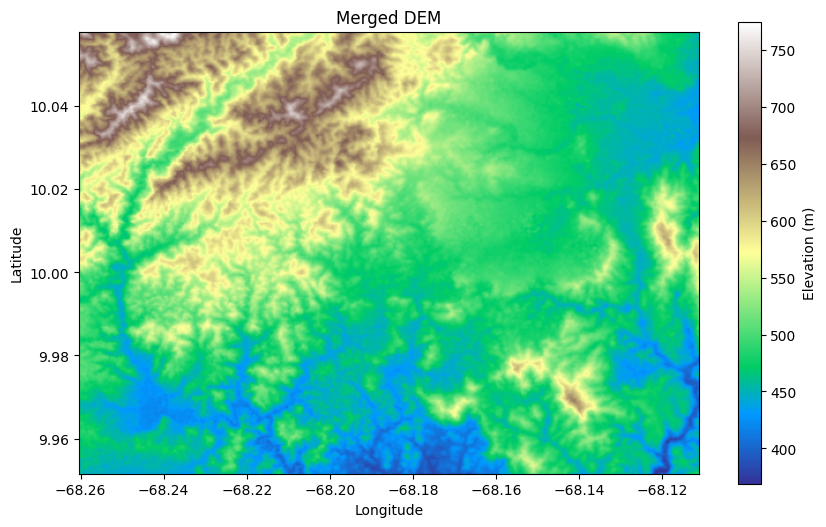

In [ ]:
import rasterio
from rasterio.merge import merge
from rasterio.plot import show
import numpy as np
import folium
import matplotlib.pyplot as plt
from google.colab import files



# Open the merged DEM for visualization
with rasterio.open("/content/AOI.tif") as dataset:
    elevation = dataset.read(1)  # Read elevation data
    transform = dataset.transform  # Transformation matrix
    bounds = dataset.bounds  # Geographic bounds

# Mask invalid values (e.g., NoData values)
elevation = np.where(elevation == dataset.nodata, np.nan, elevation)

# Display the merged DEM using matplotlib
plt.figure(figsize=(10, 6))
plt.imshow(elevation, cmap="terrain", extent=[bounds.left, bounds.right, bounds.bottom, bounds.top])
plt.colorbar(label="Elevation (m)")
plt.title("Merged DEM")
plt.xlabel("Longitude")
plt.ylabel("Latitude")
plt.show()


In [ ]:

import rasterio
import numpy as np
import plotly.graph_objects as go

# Load the DEM file
dem_path = "/content/AOI.tif"

with rasterio.open(dem_path) as dataset:
    elevation = dataset.read(1)  # Read elevation data
    transform = dataset.transform  # Transformation matrix
    bounds = dataset.bounds  # Geographic bounds
    nodata_value = dataset.nodata  # Nodata value

# Replace NoData values with NaN
elevation = np.where(elevation == nodata_value, np.nan, elevation)

# Get grid coordinates
height, width = elevation.shape
x = np.linspace(bounds.left, bounds.right, width)
y = np.linspace(bounds.top, bounds.bottom, height)  # Reverse y-axis for correct orientation
X, Y = np.meshgrid(x, y)

# Define color scale (terrain-like)
colorscale = [
    [0.0, "#3d79e0"],  # Dark blue (Low elevation)
    [0.3, "#3cde6a"],  # Green (Medium elevation)
    [0.6, "#8B4513"],  # Brown (High elevation)
    [1.0, "#DEB887"]   # Light brown (Highest elevation)
]

# Create 3D surface plot
fig = go.Figure(data=[
    go.Surface(
        z=elevation,
        x=X,
        y=Y,
        colorscale=colorscale,
        cmin=np.nanmin(elevation),
        cmax=np.nanmax(elevation)
    )
])

# Adjust layout
fig.update_layout(
    title="3D Digital Elevation Model (DEM)",
    scene=dict(
        xaxis_title="Longitude",
        yaxis_title="Latitude",
        zaxis_title="Elevation (m)",
        aspectmode="manual",
        aspectratio=dict(x=1, y=1, z=0.2)  # Adjust vertical exaggeration
    ),
    margin=dict(l=20, r=20, t=40, b=20)
)

# Show the 3D terrain
fig.show()


In [3]:
import rasterio
from rasterio.warp import transform
import geopandas as gpd
import numpy as np
import plotly.graph_objects as go

# --- File paths (update as needed) ---
dem_path = "/content/filled_reprojected_AOI.tif"
shp_path = "/content/channel_AOI.shp"

# --- Load DEM ---
with rasterio.open(dem_path) as src:
    elevation = src.read(1)
    transform_affine = src.transform
    dem_crs = src.crs
    height, width = elevation.shape
    x_coords, y_coords = np.meshgrid(np.arange(width), np.arange(height))
    lon, lat = rasterio.transform.xy(transform_affine, y_coords, x_coords, offset='center')
    lon = np.array(lon)
    lat = np.array(lat)

# --- Convert DEM coords to geographic (EPSG:4326) ---
lon_flat, lat_flat = transform(
    dem_crs, 4326,
    lon.flatten(), lat.flatten()
)
lon_grid = np.array(lon_flat).reshape(elevation.shape)
lat_grid = np.array(lat_flat).reshape(elevation.shape)

# --- Load channel shapefile and convert to geographic if needed ---
channel_gdf = gpd.read_file(shp_path)

if channel_gdf.crs != "EPSG:4326":
    channel_gdf = channel_gdf.to_crs("EPSG:4326")

channel_lines = []
for geom in channel_gdf.geometry:
    if geom.geom_type == 'LineString':
        x, y = geom.xy
        channel_lines.append((list(x), list(y)))
    elif geom.geom_type == 'MultiLineString':
        for line in geom:
            x, y = line.xy
            channel_lines.append((list(x), list(y)))

# --- Plot 3D terrain with channel overlay ---
fig = go.Figure()

# Terrain surface
fig.add_trace(go.Surface(
    x=lon_grid,
    y=lat_grid,
    z=elevation,
    colorscale='earth',
    showscale=False,
    lighting=dict(ambient=0.5, diffuse=0.5),
    opacity=0.95
))

# Channel lines
for x, y in channel_lines:
    fig.add_trace(go.Scatter3d(
        x=x,
        y=y,
        z=np.interp(x, lon_grid[0], elevation[0]),  # approximate elevation from DEM
        mode='lines',
        line=dict(color='blue', width=3),
        name='Water Channel'
    ))

fig.update_layout(
    scene=dict(
        xaxis_title="Longitude",
        yaxis_title="Latitude",
        zaxis_title="Elevation (m)",
        aspectratio=dict(x=1, y=1, z=0.2)
    ),
    title="3D Terrain with Water Channel Overlay"
)

fig.show()


/usr/local/lib/python3.11/dist-packages/pyogrio/raw.py:198: UserWarning: Measured (M) geometry types are not supported. Original type 'Measured 3D LineString' is converted to 'LineString Z'
  return ogr_read(


In [4]:
import rasterio
import geopandas as gpd
import numpy as np
import plotly.graph_objects as go
from rasterio.transform import xy

# --- File paths ---
dem_path = "/content/filled_reprojected_AOI.tif"  # REGVEN projected
shp_path = "/content/channel_AOI.shp"             # Should be same CRS

# --- Load DEM ---
with rasterio.open(dem_path) as src:
    dem = src.read(1)
    transform = src.transform
    crs = src.crs
    bounds = src.bounds

    # Create coordinate grids in REGVEN projection
    x = np.linspace(bounds.left, bounds.right, dem.shape[1])
    y = np.linspace(bounds.top, bounds.bottom, dem.shape[0])
    X, Y = np.meshgrid(x, y)

# --- Load and process channels ---
gdf = gpd.read_file(shp_path).to_crs(crs)  # Ensure matching CRS

# Collect channel coordinates with elevation sampling
channel_segments = []

with rasterio.open(dem_path) as src:
    for geom in gdf.geometry:
        if geom.geom_type in ["LineString", "MultiLineString"]:
            # Handle both LineString and MultiLineString
            lines = geom.geoms if geom.geom_type == "MultiLineString" else [geom]

            for line in lines:
                segment = {'x': [], 'y': [], 'z': []}
                for coord in list(line.coords):
                    x, y = coord[:2]  # Take only first two values
                    try:
                        # Convert to pixel coordinates
                        row, col = src.index(x, y)
                        elevation = src.read(1)[row, col]
                        segment['x'].append(x)
                        segment['y'].append(y)
                        segment['z'].append(float(elevation) + 0.2)  # Slight offset
                    except (IndexError, ValueError):
                        continue  # Skip points outside the DEM

                # Only add segments with valid points
                if len(segment['x']) > 1:
                    channel_segments.append(segment)

# --- Create 3D Visualization ---
fig = go.Figure()

# Terrain surface
fig.add_trace(go.Surface(
    x=X,
    y=Y,
    z=dem,
    colorscale='Viridis',
    opacity=0.9,
    name='DEM',
    contours_z=dict(show=True, width=1),
    lighting=dict(
        ambient=0.7,
        diffuse=0.9,
        roughness=0.1,
        specular=0.2
    )
))

# Add water channels with proper elevation
for i, seg in enumerate(channel_segments):
    fig.add_trace(go.Scatter3d(
        x=seg['x'],
        y=seg['y'],
        z=seg['z'],
        mode='lines',
        line=dict(color='royalblue', width=6),
        name=f'Channel {i+1}',
        hoverinfo='z+text',
        text=[f"Elev: {z:.1f}m" for z in seg['z']]
    ))

# Configure layout
fig.update_layout(
    title='3D Terrain with Water Channels (REGVEN Projection)',
    scene=dict(
        xaxis_title='Easting (m)',
        yaxis_title='Northing (m)',
        zaxis_title='Elevation (m)',
        aspectmode='manual',
        aspectratio=dict(x=1, y=dem.shape[1]/dem.shape[0], z=0.2),
        camera=dict(
            eye=dict(x=1.5, y=1.5, z=0.8),
            up=dict(x=0, y=0, z=1)
        )
    ),
    margin=dict(l=0, r=0, t=40, b=0)
)

fig.show()

/usr/local/lib/python3.11/dist-packages/pyogrio/raw.py:198: UserWarning:

Measured (M) geometry types are not supported. Original type 'Measured 3D LineString' is converted to 'LineString Z'



In [14]:
import rasterio
from rasterio.warp import calculate_default_transform, reproject, Resampling
import geopandas as gpd
import numpy as np
import plotly.graph_objects as go
from pyproj import Transformer

# --- File paths ---
dem_path = "/content/filled_reprojected_AOI.tif"  # REGVEN projected
shp_path = "/content/channel_AOI.shp"             # Should be same CRS

# --- Step 1: Reproject DEM to WGS84 (EPSG:4326) ---
dst_crs = 'EPSG:4326'  # WGS84

with rasterio.open(dem_path) as src:
    # Calculate transformation parameters
    transform, width, height = calculate_default_transform(
        src.crs, dst_crs, src.width, src.height, *src.bounds)

    # Create new metadata for reprojected DEM
    metadata = src.meta.copy()
    metadata.update({
        'crs': dst_crs,
        'transform': transform,
        'width': width,
        'height': height
    })

    # Reproject the data
    reprojected_dem = np.empty((height, width), dtype=np.float32)
    reproject(
        source=src.read(1),
        destination=reprojected_dem,
        src_transform=src.transform,
        src_crs=src.crs,
        dst_transform=transform,
        dst_crs=dst_crs,
        resampling=Resampling.bilinear)

# --- Step 2: Process channels in WGS84 ---
gdf = gpd.read_file(shp_path).to_crs(dst_crs)  # Convert to WGS84

# Create coordinate transformer for elevation sampling (REGVEN → WGS84)
transformer = Transformer.from_crs(dst_crs, src.crs, always_xy=True)

# Collect channel coordinates with elevation sampling
channel_segments = []

with rasterio.open(dem_path) as src:  # Original DEM for elevation data
    for geom in gdf.geometry:
        if geom.geom_type in ["LineString", "MultiLineString"]:
            lines = geom.geoms if geom.geom_type == "MultiLineString" else [geom]

            for line in lines:
                segment = {'lon': [], 'lat': [], 'elev': []}
                for coord in list(line.coords):
                    lon, lat = coord[:2]  # WGS84 coordinates

                    # Convert back to REGVEN for elevation sampling
                    x, y = transformer.transform(lon, lat)

                    try:
                        row, col = src.index(x, y)
                        elevation = src.read(1)[row, col]
                        segment['lon'].append(lon)
                        segment['lat'].append(lat)
                        segment['elev'].append(float(elevation) + 0.5)  # Slight offset
                    except (IndexError, ValueError):
                        continue

                if len(segment['lon']) > 1:
                    channel_segments.append(segment)

# --- Step 3: Prepare WGS84 coordinate grids ---
with rasterio.open(dem_path) as src:  # Original for transform
    # Create WGS84 coordinate grids
    lon = np.linspace(transform[2], transform[2] + width * transform[0], width)
    lat = np.linspace(transform[5], transform[5] + height * transform[4], height)
    Lon, Lat = np.meshgrid(lon, lat)

# --- Step 4: Create 3D Visualization ---
fig = go.Figure()

# Terrain surface in WGS84
fig.add_trace(go.Surface(
    x=Lon,
    y=Lat,
    z=reprojected_dem,
    colorscale='Viridis',
    opacity=0.9,
    name='DEM',
    contours_z=dict(show=True, width=1),
    lighting=dict(
        ambient=0.7,
        diffuse=0.9,
        roughness=0.1,
        specular=0.2
    )
))

# Add water channels
for i, seg in enumerate(channel_segments):
    fig.add_trace(go.Scatter3d(
        x=seg['lon'],
        y=seg['lat'],
        z=seg['elev'],
        mode='lines',
        line=dict(color='royalblue', width=8),
        name=f'Channel {i+1}',
        hoverinfo='text+z',
        text=[f"Elev: {elev:.1f}m" for elev in seg['elev']]
    ))

# Configure layout with geographic context
fig.update_layout(
    title='3D Terrain with Water Channels (WGS84)',
    scene=dict(
        xaxis_title='Longitude',
        yaxis_title='Latitude',
        zaxis_title='Elevation (m)',
        aspectmode='manual',
        aspectratio=dict(x=1, y=1, z=0.1),  # Adjusted for geographic coords
        camera=dict(
            eye=dict(x=1.25, y=1.25, z=0.8),  # Adjusted view angle
            up=dict(x=0, y=0, z=1)
        )
    ),
    margin=dict(l=0, r=0, t=40, b=0),
    geo=dict(
        projection_type='orthographic',
        showland=True,
        landcolor='rgb(243, 243, 243)',
        countrycolor='rgb(204, 204, 204)'
    )
)

fig.show()

/usr/local/lib/python3.11/dist-packages/pyogrio/raw.py:198: UserWarning:

Measured (M) geometry types are not supported. Original type 'Measured 3D LineString' is converted to 'LineString Z'



In [16]:
import rasterio
from rasterio.warp import calculate_default_transform, reproject, Resampling
import geopandas as gpd
import numpy as np
import plotly.graph_objects as go
from pyproj import Transformer

# --- File paths ---
dem_path = "/content/filled_reprojected_AOI.tif"
shp_path = "/content/channel_AOI.shp"

# --- 1. Reproject DEM to WGS84 ---
dst_crs = 'EPSG:4326'  # WGS84

with rasterio.open(dem_path) as src:
    # Get original elevation range
    min_elev = np.nanmin(src.read(1))
    max_elev = np.nanmax(src.read(1))
    elevation_range = max_elev - min_elev

    transform, width, height = calculate_default_transform(
        src.crs, dst_crs, src.width, src.height, *src.bounds)

    metadata = src.meta.copy()
    metadata.update({
        'crs': dst_crs,
        'transform': transform,
        'width': width,
        'height': height
    })

    reprojected_dem = np.empty((height, width), dtype=np.float32)
    reproject(
        source=src.read(1),
        destination=reprojected_dem,
        src_transform=src.transform,
        src_crs=src.crs,
        dst_transform=transform,
        dst_crs=dst_crs,
        resampling=Resampling.bilinear)

# --- 2. Process channels ---
gdf = gpd.read_file(shp_path).to_crs(dst_crs)
transformer = Transformer.from_crs(dst_crs, src.crs, always_xy=True)

channel_segments = []
with rasterio.open(dem_path) as src:
    for geom in gdf.geometry:
        if geom.geom_type in ["LineString", "MultiLineString"]:
            lines = geom.geoms if geom.geom_type == "MultiLineString" else [geom]

            for line in lines:
                segment = {'lon': [], 'lat': [], 'elev': []}
                for coord in list(line.coords):
                    lon, lat = coord[:2]
                    x, y = transformer.transform(lon, lat)

                    try:
                        row, col = src.index(x, y)
                        elevation = src.read(1)[row, col]
                        segment['lon'].append(lon)
                        segment['lat'].append(lat)
                        segment['elev'].append(float(elevation))
                    except (IndexError, ValueError):
                        continue

                if len(segment['lon']) > 1:
                    channel_segments.append(segment)

# --- 3. Create 3D Visualization with Adjusted Z-axis ---
fig = go.Figure()

# Calculate Z-axis parameters
z_min = min_elev - 0.1 * elevation_range  # 10% below min elevation
z_max = max_elev + 0.1 * elevation_range  # 10% above max elevation

# Terrain surface
fig.add_trace(go.Surface(
    x=np.linspace(transform[2], transform[2] + width * transform[0], width),
    y=np.linspace(transform[5], transform[5] + height * transform[4], height),
    z=reprojected_dem,
    colorscale='Viridis',
    cmin=min_elev,
    cmax=max_elev,
    opacity=0.9,
    name='Elevation',
    contours_z=dict(
        show=True,
        start=min_elev,
        end=max_elev,
        size=elevation_range/10,
        color='gray'
    )
))

# Add water channels
for i, seg in enumerate(channel_segments):
    fig.add_trace(go.Scatter3d(
        x=seg['lon'],
        y=seg['lat'],
        z=seg['elev'],
        mode='lines',
        line=dict(color='blue', width=4),
        name=f'Channel {i+1}'
    ))

# Configure layout with proper Z-axis
fig.update_layout(
    title=f'3D Terrain Model<br>Elevation Range: {min_elev:.0f}m - {max_elev:.0f}m',
    scene=dict(
        xaxis_title='Longitude',
        yaxis_title='Latitude',
        zaxis_title='Elevation (m)',
        zaxis=dict(
            range=[z_min, z_max],  # Set explicit Z-axis range
            nticks=10  # Number of ticks on Z-axis
        ),
        aspectratio=dict(x=1, y=1, z=0.04*(elevation_range/100)),  # Dynamic Z-scaling
        camera=dict(
            eye=dict(x=1.5, y=1.5, z=0.8)
        )
    ),
    margin=dict(l=0, r=0, t=80, b=0)
)

fig.show()

/usr/local/lib/python3.11/dist-packages/pyogrio/raw.py:198: UserWarning:

Measured (M) geometry types are not supported. Original type 'Measured 3D LineString' is converted to 'LineString Z'

